Installing the surprise library

In [2]:
!pip install scikit-surprise
!pip install tensorflow

     -------------------------------------- 266.3/266.3 MB 1.3 MB/s eta 0:00:00
     -------------------------------------- 895.9/895.9 kB 1.4 MB/s eta 0:00:00
     ---------------------------------------- 1.5/1.5 MB 1.7 MB/s eta 0:00:00
     ---------------------------------------- 1.7/1.7 MB 1.9 MB/s eta 0:00:00
     -------------------------------------- 126.5/126.5 kB 1.9 MB/s eta 0:00:00
     -------------------------------------- 439.2/439.2 kB 2.0 MB/s eta 0:00:00
     ---------------------------------------- 3.7/3.7 MB 2.0 MB/s eta 0:00:00
     -------------------------------------- 23.2/23.2 MB 867.0 kB/s eta 0:00:00
     ---------------------------------------- 65.5/65.5 kB 1.2 MB/s eta 0:00:00
     -------------------------------------- 57.5/57.5 kB 605.5 kB/s eta 0:00:00
     ---------------------------------------- 6.0/6.0 MB 1.1 MB/s eta 0:00:00
     -------------------------------------- 177.2/177.2 kB 1.3 MB/s eta 0:00:00
     -------------------------------------- 781.

import it + necessary modules


In [2]:
import surprise
from surprise import Dataset
from surprise import Reader
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from surprise import Reader, Dataset
from surprise.model_selection import train_test_split
from surprise import accuracy
from surprise.prediction_algorithms import knns, matrix_factorization
from surprise import NMF, CoClustering

Load the necessary data files

In [11]:
student_info = pd.read_csv('../Data Files/studentInfo.csv')
student_assessment = pd.read_csv('../Data Files/studentAssessment.csv')
student_vle = pd.read_csv('../Data Files/studentVle.csv')
vle = pd.read_csv('../Data Files/vle.csv')

Divide the necessary variables from each data file


In [12]:
student_info = student_info[['code_module', 'code_presentation', 'id_student', 'gender', 'region', 'highest_education', 
                             'imd_band', 'age_band', 'num_of_prev_attempts', 'disability']]
student_assessment = student_assessment[['id_student', 'id_assessment', 'date_submitted', 'is_banked', 'score']]
student_vle = student_vle[['code_module', 'code_presentation', 'id_student', 'id_site', 'sum_click']]

Merge the dataframes


In [13]:
merged_df = pd.merge(student_info, student_assessment, on='id_student', how='inner')
merged_df = pd.merge(merged_df, student_vle, on=['id_student', 'code_module', 'code_presentation'], how='inner')

In [5]:
merged_df.tail(2000)

,code_module,code_presentation,id_student,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,disability,id_assessment,date_submitted,is_banked,score,id_site,sum_click
101767008,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,Y,37438,95,0,60.0,896943,2
101767009,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,Y,37438,95,0,60.0,896945,1
101767010,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,Y,37438,95,0,60.0,896981,1
101767011,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,Y,37438,95,0,60.0,897151,1
101767012,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,Y,37438,95,0,60.0,896981,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101769003,GGG,2014J,2684003,F,Yorkshire Region,HE Qualification,50-60%,35-55,0,N,37441,206,0,100.0,896961,13
101769004,GGG,2014J,2684003,F,Yorkshire Region,HE Qualification,50-60%,35-55,0,N,37441,206,0,100.0,896959,2
101769005,GGG,2014J,2684003,F,Yorkshire Region,HE Qualification,50-60%,35-55,0,N,37441,206,0,100.0,896943,1
101769006,GGG,2014J,2684003,F,Yorkshire Region,HE Qualification,50-60%,35-55,0,N,37441,206,0,100.0,896961,31


In [15]:
merged_df.shape

(101769008, 16)

aggregate the data based on sum click for each id_site (summing makes sense because the date of VLE interaction is irrelevant)

In [14]:
grouped_df = merged_df.groupby(['id_student', 'code_module', 'code_presentation', 'id_site']).agg({
    'gender': 'first',
    'region': 'first',
    'highest_education': 'first',
    'imd_band': 'first',
    'age_band': 'first',
    'num_of_prev_attempts' : 'first',
    'disability': 'first',
    'id_assessment': 'first',
    'date_submitted': 'first',
    'is_banked': 'first',
    'score': 'first',
    'sum_click': 'sum'
}).reset_index()

In [7]:
grouped_df.head(2000)

,id_student,code_module,code_presentation,id_site,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,disability,id_assessment,date_submitted,is_banked,score,sum_click
0,6516,AAA,2014J,877011,M,Scotland,HE Qualification,80-90%,55<=,0,N,1758,17,0,60.0,115
1,6516,AAA,2014J,877012,M,Scotland,HE Qualification,80-90%,55<=,0,N,1758,17,0,60.0,1525
2,6516,AAA,2014J,877015,M,Scotland,HE Qualification,80-90%,55<=,0,N,1758,17,0,60.0,130
3,6516,AAA,2014J,877023,M,Scotland,HE Qualification,80-90%,55<=,0,N,1758,17,0,60.0,30
4,6516,AAA,2014J,877025,M,Scotland,HE Qualification,80-90%,55<=,0,N,1758,17,0,60.0,455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,28046,DDD,2013J,674047,F,Yorkshire Region,HE Qualification,10-20,35-55,0,N,25348,25,0,58.0,21
1996,28046,DDD,2013J,674049,F,Yorkshire Region,HE Qualification,10-20,35-55,0,N,25348,25,0,58.0,14
1997,28046,DDD,2013J,674053,F,Yorkshire Region,HE Qualification,10-20,35-55,0,N,25348,25,0,58.0,14
1998,28046,DDD,2013J,674054,F,Yorkshire Region,HE Qualification,10-20,35-55,0,N,25348,25,0,58.0,77


In [8]:
grouped_df.shape


(1920298, 16)

In depth data analysis before building the model

Descriptive statistics

In [9]:
#size of the data
print("Number of rows: ", grouped_df.shape[0])
print("Number of columns: ", grouped_df.shape[1])

Number of rows:  1920298
Number of columns:  16


In [10]:
#checking missing values
print(grouped_df.isnull().sum())

id_student                   0
code_module                  0
code_presentation            0
id_site                      0
gender                       0
region                       0
highest_education            0
imd_band                106942
age_band                     0
num_of_prev_attempts         0
disability                   0
id_assessment                0
date_submitted               0
is_banked                    0
score                      352
sum_click                    0
dtype: int64


imd_band 106942 missing values / score 352 missing values, we may drop imd_band and try to use the median or mean for score, we'll see what we'll do

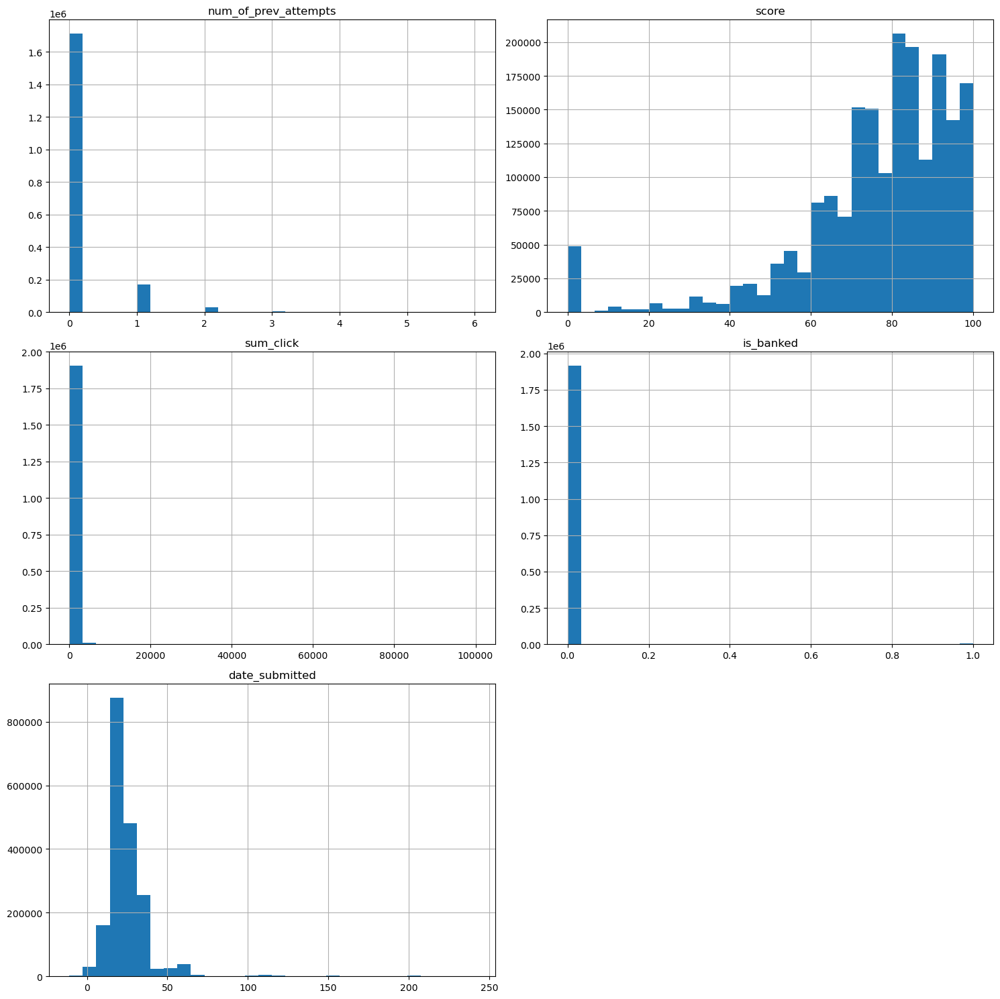

In [11]:
#checking the distribution of each column using histograms
included_cols = ['num_of_prev_attempts','score','sum_click','is_banked','date_submitted']
grouped_df[included_cols].hist(figsize=(15, 15), bins=30)
plt.tight_layout()
plt.show()

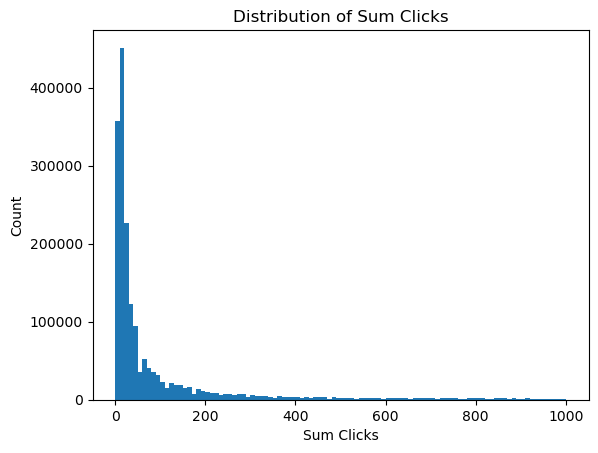

In [12]:
#redisplay the sum_clicks data because it's unclear
plt.hist(grouped_df["sum_click"], bins=100, range=(0, 1000))
plt.title("Distribution of Sum Clicks")
plt.xlabel("Sum Clicks")
plt.ylabel("Count")
plt.show()

## Checking the reason behind having 50000 observations with 0 score 

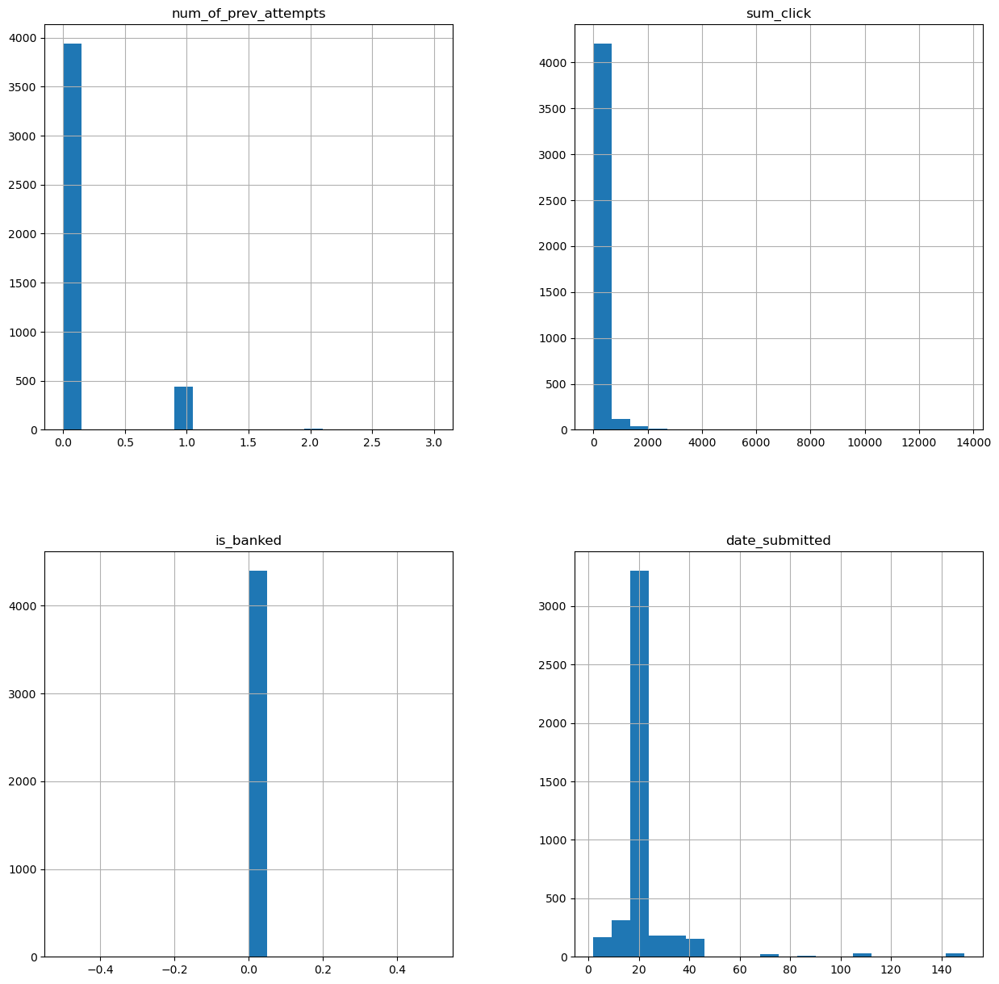

In [13]:
score_zero_df = grouped_df[grouped_df['score'] == 0]
included_cols = ['highest_education', 'imd_band', 'age_band', 'num_of_prev_attempts', 'sum_click', 'is_banked', 'date_submitted', 'gender', 'region', 'disability']

score_zero_df[included_cols].hist(figsize=(15, 15), bins=20)
plt.show()

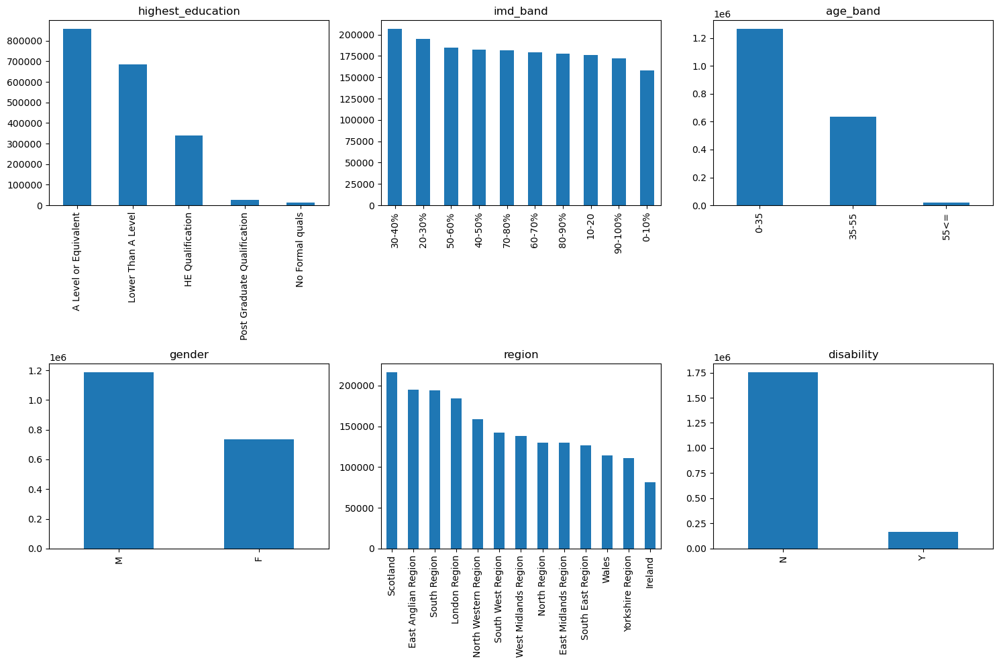

In [14]:
#checking the distribution of each categorical column using bar plots
categorical_vars = ['highest_education', 'imd_band', 'age_band', 'gender', 'region', 'disability']

fig, axs = plt.subplots(2, 3, figsize=(15, 10))
axs = axs.flatten()

for i, var in enumerate(categorical_vars):
    grouped_df[var].value_counts().plot(kind='bar', ax=axs[i])
    axs[i].set_title(var)
    axs[i].set_xlabel('')

plt.tight_layout()
plt.show()

study each histogram and each bar plot to see if some things are abnormal and need normalizations


In [15]:
#there are extreme values in date_submitted, -11 to 608 , we've set it to 0 & 365
df_cleaned = grouped_df[(grouped_df['date_submitted'] >= 0) & (grouped_df['date_submitted'] <= 365)]

# there is quite a lot of people with 0 score, who are inactive, so we'll remove them
df_cleaned = df_cleaned[df_cleaned['score'] > 0]

#drop the observations with missing score values : 352 missing values
df_cleaned.dropna(subset=['score'], inplace=True)

print(df_cleaned.shape)
print(df_cleaned.isnull().sum())

(1905380, 16)
id_student                   0
code_module                  0
code_presentation            0
id_site                      0
gender                       0
region                       0
highest_education            0
imd_band                106611
age_band                     0
num_of_prev_attempts         0
disability                   0
id_assessment                0
date_submitted               0
is_banked                    0
score                        0
sum_click                    0
dtype: int64


Correlation Analysis

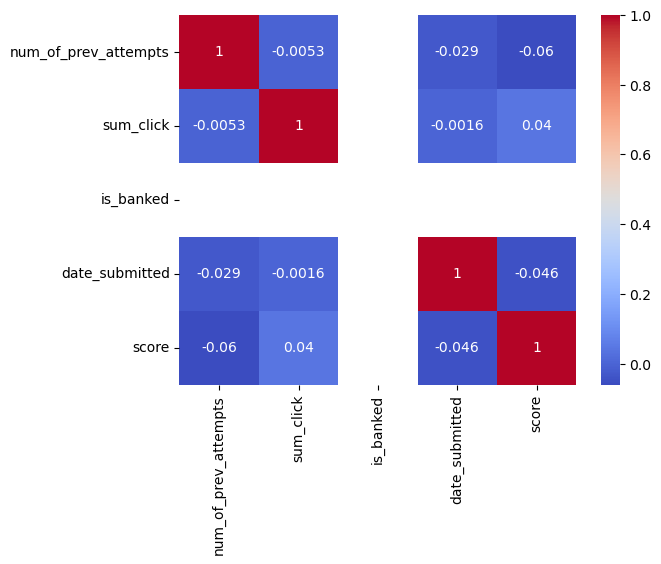

In [16]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt



# Select the columns to include in the correlation analysis
cols = ['highest_education', 'imd_band', 'age_band', 'num_of_prev_attempts',
        'sum_click', 'is_banked', 'date_submitted', 'gender', 'region',
        'disability','score']

# Compute the correlation matrix
corr = df_cleaned[cols].corr()

# Visualize the correlation matrix using a heatmap
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()


## Modeling to treat missing values : imd_band 106611 missing values

## Conversion of the imd_band values, and splitting the data 

In [16]:

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score
from tqdm import tqdm

# Define functions for converting between imd_band and percentage
def convert_imd_band(imd_band):
    if imd_band == '0-10%':
        return 0
    elif imd_band == '10-20':
        return 1
    elif imd_band == '20-30%':
        return 2
    elif imd_band == '30-40%':
        return 3
    elif imd_band == '40-50%':
        return 4
    elif imd_band == '50-60%':
        return 5
    elif imd_band == '60-70%':
        return 6
    elif imd_band == '70-80%':
        return 7
    elif imd_band == '80-90%':
        return 8
    elif imd_band == '90-100%':
        return 9


# categorical columns in the data
cat_cols = ['code_module', 'code_presentation', 'gender', 'region', 'highest_education', 'age_band', 'disability']

# Split the data into two parts: one with missing values in imd_band, and another with no missing values
df_missing = df_cleaned[df_cleaned['imd_band'].isna()]
df_not_missing = df_cleaned[~df_cleaned['imd_band'].isna()]

# Split df_not_missing into train and test sets
X_train, X_test, y_train_cat, y_test_cat = train_test_split(df_not_missing.drop('imd_band', axis=1), df_not_missing['imd_band'], test_size=0.2, random_state=42)

# Convert categorical values to numerical values
y_train = y_train_cat.apply(convert_imd_band)
y_test = y_test_cat.apply(convert_imd_band)


In [18]:
df_missing.head(200)

,id_student,code_module,code_presentation,id_site,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,disability,id_assessment,date_submitted,is_banked,score,sum_click
3098,29639,CCC,2014J,909013,M,North Region,Lower Than A Level,None,0-35,0,N,24291,32,0,90.0,11674
3099,29639,CCC,2014J,909014,M,North Region,Lower Than A Level,None,0-35,0,N,24291,32,0,90.0,1469
3100,29639,CCC,2014J,909016,M,North Region,Lower Than A Level,None,0-35,0,N,24291,32,0,90.0,1924
3101,29639,CCC,2014J,909018,M,North Region,Lower Than A Level,None,0-35,0,N,24291,32,0,90.0,10439
3102,29639,CCC,2014J,909019,M,North Region,Lower Than A Level,None,0-35,0,N,24291,32,0,90.0,3562
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7078,37298,FFF,2013B,526825,M,Ireland,HE Qualification,None,0-35,0,N,34860,19,0,92.0,33
7079,37298,FFF,2013B,526827,M,Ireland,HE Qualification,None,0-35,0,N,34860,19,0,92.0,473
7080,37298,FFF,2013B,526831,M,Ireland,HE Qualification,None,0-35,0,N,34860,19,0,92.0,308
7081,37298,FFF,2013B,526833,M,Ireland,HE Qualification,None,0-35,0,N,34860,19,0,92.0,297


In [17]:
from sklearn.preprocessing import OneHotEncoder
import numpy as np
# categorical columns in the data
cat_cols = ['code_module', 'code_presentation', 'gender', 'region', 'highest_education', 'age_band', 'disability']

# initialize the encoder
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)

# fit the encoder on the categorical columns of the training data
encoder.fit(X_train[cat_cols])

# transform the categorical columns of the training and test data
X_train_encoded = encoder.transform(X_train[cat_cols])
X_test_encoded = encoder.transform(X_test[cat_cols])
df_missing_encoded = encoder.transform(df_missing[cat_cols])

# get the names of the encoded columns
cat_col_names = encoder.get_feature_names_out(cat_cols)

# concatenate the encoded columns with the non-categorical columns
X_train_processed = np.concatenate((X_train_encoded, X_train.drop(cat_cols, axis=1)), axis=1)
X_test_processed = np.concatenate((X_test_encoded, X_test.drop(cat_cols, axis=1)), axis=1)
df_missing_processed = np.concatenate((df_missing_encoded, df_missing.drop(cat_cols + ['imd_band'], axis=1)), axis=1)

# print the first five rows of the processed training data
print(X_train_processed[:5])
# print the column names of the processed training data
col_names = np.concatenate((cat_col_names, X_train.drop(cat_cols, axis=1).columns))
print(col_names)



df_missing_processed_df = pd.DataFrame(data=df_missing_processed, columns=col_names)
df_missing_processed_df.head(300)
#X_train_df = pd.DataFrame(X_train_processed, columns=col_names)
#X_train_df.head(200)

[[0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00
  1.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00
  5.89894e+05 7.29671e+05 0.00000e+00 2.42860e+04 2.00000e+01 0.00000e+00
  6.00000e+01 2.15000e+02]
 [0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00
  0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  1.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00
  0.00000e+00 1.00000e+00 0.00000e+00 0.00000e+00 1.00000e+00 0.00000e+00
  5.98213e+

,code_module_AAA,code_module_BBB,code_module_CCC,code_module_DDD,code_module_EEE,code_module_FFF,code_module_GGG,code_presentation_2013B,code_presentation_2013J,code_presentation_2014B,...,disability_N,disability_Y,id_student,id_site,num_of_prev_attempts,id_assessment,date_submitted,is_banked,score,sum_click
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29639.0,909013.0,0.0,24291.0,32.0,0.0,90.0,11674.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29639.0,909014.0,0.0,24291.0,32.0,0.0,90.0,1469.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29639.0,909016.0,0.0,24291.0,32.0,0.0,90.0,1924.0
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29639.0,909018.0,0.0,24291.0,32.0,0.0,90.0,10439.0
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29639.0,909019.0,0.0,24291.0,32.0,0.0,90.0,3562.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,40604.0,729791.0,0.0,24282.0,32.0,0.0,90.0,175.0
296,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,40604.0,729797.0,0.0,24282.0,32.0,0.0,90.0,77.0
297,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,40604.0,729801.0,0.0,24282.0,32.0,0.0,90.0,7.0
298,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,40604.0,729810.0,0.0,24282.0,32.0,0.0,90.0,35.0


In [18]:
n_samples, n_features = X_train_encoded.shape
n_samples, n_features_processed = X_train_processed.shape
print(f"Training set contains {n_samples} samples and {n_features} features.")

Training set contains 1439015 samples and 36 features.


In [19]:
# concatenate the processed training and test data
X_processed = np.concatenate((X_train_processed, X_test_processed), axis=0)
X_processed_df = pd.DataFrame(X_processed, columns=col_names)

y_processed = np.concatenate((y_train, y_test), axis=0)

# concatenate the original non-missing data and the processed missing data
df_not_missing_processed = pd.concat([X_processed_df, pd.DataFrame(data=y_processed, columns=['imd_band'])], axis=1)

In [33]:
print(X_train_processed.shape)

(1439015, 44)


### This code trains the XGBoost model, do not re-run.

In [20]:
from tqdm import tqdm
# Train an XGBoost model
from xgboost import XGBClassifier


xgb_model = XGBClassifier(n_estimators=150, max_depth=7, objective='multi:softmax', num_class=10, verbosity=1, tree_method='gpu_hist')

# Track progress
for i in tqdm(range(100)):
    xgb_model.fit(X_train_encoded, y_train)

100%|██████████| 100/100 [1:06:33<00:00, 39.93s/it]


### This compares the real and predicted values 

In [21]:
from sklearn.metrics import accuracy_score

# Generate predictions for the test set
y_pred = xgb_model.predict(X_test_encoded)

# Compare predicted vs actual values
for i in range(len(y_test)):
    print(f"Predicted: {y_pred[i]} | Real: {y_test.iloc[i]}")

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")


Predicted: 4 | Real: 6
Predicted: 9 | Real: 9
Predicted: 9 | Real: 9
Predicted: 1 | Real: 7
Predicted: 0 | Real: 8
Predicted: 3 | Real: 9
Predicted: 1 | Real: 1
Predicted: 7 | Real: 7
Predicted: 9 | Real: 0
Predicted: 8 | Real: 8
Predicted: 8 | Real: 8
Predicted: 2 | Real: 0
Predicted: 0 | Real: 8
Predicted: 6 | Real: 6
Predicted: 8 | Real: 7
Predicted: 3 | Real: 0
Predicted: 6 | Real: 6
Predicted: 7 | Real: 7
Predicted: 4 | Real: 4
Predicted: 1 | Real: 8
Predicted: 0 | Real: 8
Predicted: 1 | Real: 8
Predicted: 8 | Real: 3
Predicted: 3 | Real: 9
Predicted: 0 | Real: 0
Predicted: 7 | Real: 2
Predicted: 1 | Real: 8
Predicted: 0 | Real: 5
Predicted: 3 | Real: 3
Predicted: 9 | Real: 8
Predicted: 3 | Real: 8
Predicted: 8 | Real: 2
Predicted: 1 | Real: 5
Predicted: 7 | Real: 8
Predicted: 0 | Real: 4
Predicted: 7 | Real: 9
Predicted: 2 | Real: 3
Predicted: 8 | Real: 8
Predicted: 3 | Real: 2
Predicted: 0 | Real: 1
Predicted: 0 | Real: 6
Predicted: 5 | Real: 5
Predicted: 0 | Real: 2
Predicted: 

### HYPER PARAMETER TUNING USING Grid Search

In [31]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid to search over
param_grid = {
    'learning_rate': [0.1, 0.01, 0.001],
    'max_depth': [3, 5, 7],
    'n_estimators': [50, 100, 150]
}

# Create an XGBClassifier
xgb_model = XGBClassifier(objective='multi:softmax', num_class=10, verbosity=1, tree_method='gpu_hist')

# Use GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(xgb_model, param_grid, cv=3)
grid_search.fit(X_train_encoded, y_train)

# Print the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

Best hyperparameters: {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 150}







THIS IS TO SAVE THE TRAINED XGBoost MODEL


In [22]:
import pickle

# Save the trained model
with open('xgb_model_tuned.pickle', 'wb') as f:
    pickle.dump(xgb_model, f)

THIS IS TO LOAD THE TRAINED XGBoost MODEL

In [6]:
import pickle

# Load the saved model
with open('../Saved Models/xgb_model_tuned.pickle', 'rb') as f:
    xgb_model = pickle.load(f)

## Because of the weak correlations, we'll try a Neural Network, maybe it'll yield better results.

In [25]:
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers

X_train_encoded_dense = X_train_encoded.toarray()
X_test_encoded_dense = X_test_encoded.toarray()

model = keras.Sequential([
    layers.Dense(128, activation='relu', input_shape=[n_features]),
    layers.Dense(64, activation='relu'),
    layers.Dense(32, activation='relu'),
    layers.Dense(10, activation='softmax')
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

history = model.fit(X_train_encoded_dense, y_train, epochs=75, validation_data=(X_test_encoded_dense, y_test))
print(history.history['accuracy']) # training accuracy
print(history.history['val_accuracy']) # validation accuracy


# Evaluate model on test set
#test_loss, test_accuracy = model.evaluate(X_test_encoded, y_test)
#print('Test accuracy:', test_accuracy)

# Get predictions for training data
#train_preds = model.predict(X_train_encoded)

# Calculate training accuracy
#train_acc = accuracy_score(y_train, train_preds)
#print(f"Training accuracy: {train_acc}")



Epoch 1/75
44970/44970 [==============================] - 61s 1ms/step - loss: 1.9459 - accuracy: 0.2774 - val_loss: 1.8290 - val_accuracy: 0.3139
Epoch 2/75
44970/44970 [==============================] - 56s 1ms/step - loss: 1.7879 - accuracy: 0.3262 - val_loss: 1.7636 - val_accuracy: 0.3320
Epoch 3/75
44970/44970 [==============================] - 50s 1ms/step - loss: 1.7486 - accuracy: 0.3352 - val_loss: 1.7372 - val_accuracy: 0.3374
Epoch 4/75
44970/44970 [==============================] - 46s 1ms/step - loss: 1.7274 - accuracy: 0.3405 - val_loss: 1.7258 - val_accuracy: 0.3400
Epoch 5/75
44970/44970 [==============================] - 48s 1ms/step - loss: 1.7142 - accuracy: 0.3430 - val_loss: 1.7069 - val_accuracy: 0.3461
Epoch 6/75
44970/44970 [==============================] - 53s 1ms/step - loss: 1.7040 - accuracy: 0.3447 - val_loss: 1.7006 - val_accuracy: 0.3462
Epoch 7/75
44970/44970 [==============================] - 51s 1ms/step - loss: 1.6957 - accuracy: 0.3464 - val_loss: 1

### Comparison of the predicted vs real results

In [28]:
# Generate predictions for the test set
y_pred = model.predict(X_test_encoded_dense)

# Convert predicted probabilities to class labels
y_pred_classes = np.argmax(y_pred, axis=1)

# Compare predicted vs actual values
for i in range(len(y_test)):
    print(f"Predicted: {y_pred_classes[i]} | Real: {y_test.iloc[i]}")

11243/11243 [==============================] - 8s 671us/step
Predicted: 6 | Real: 6
Predicted: 9 | Real: 9
Predicted: 9 | Real: 9
Predicted: 1 | Real: 7
Predicted: 0 | Real: 8
Predicted: 9 | Real: 9
Predicted: 1 | Real: 1
Predicted: 7 | Real: 7
Predicted: 8 | Real: 0
Predicted: 8 | Real: 8
Predicted: 4 | Real: 8
Predicted: 2 | Real: 0
Predicted: 4 | Real: 8
Predicted: 9 | Real: 6
Predicted: 6 | Real: 7
Predicted: 1 | Real: 0
Predicted: 6 | Real: 6
Predicted: 7 | Real: 7
Predicted: 4 | Real: 4
Predicted: 2 | Real: 8
Predicted: 0 | Real: 8
Predicted: 1 | Real: 8
Predicted: 8 | Real: 3
Predicted: 5 | Real: 9
Predicted: 0 | Real: 0
Predicted: 8 | Real: 2
Predicted: 1 | Real: 8
Predicted: 0 | Real: 5
Predicted: 3 | Real: 3
Predicted: 9 | Real: 8
Predicted: 3 | Real: 8
Predicted: 2 | Real: 2
Predicted: 1 | Real: 5
Predicted: 8 | Real: 8
Predicted: 9 | Real: 4
Predicted: 6 | Real: 9
Predicted: 9 | Real: 3
Predicted: 8 | Real: 8
Predicted: 3 | Real: 2
Predicted: 9 | Real: 1
Predicted: 0 | Real

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



11243/11243 [==============================] - 7s 651us/step
Predicted: 6 | Real: 6
Predicted: 9 | Real: 9
Predicted: 9 | Real: 9
Predicted: 1 | Real: 7
Predicted: 0 | Real: 8
Predicted: 9 | Real: 9
Predicted: 1 | Real: 1
Predicted: 7 | Real: 7
Predicted: 8 | Real: 0
Predicted: 8 | Real: 8
Predicted: 4 | Real: 8
Predicted: 2 | Real: 0
Predicted: 4 | Real: 8
Predicted: 9 | Real: 6
Predicted: 6 | Real: 7
Predicted: 1 | Real: 0
Predicted: 6 | Real: 6
Predicted: 7 | Real: 7
Predicted: 4 | Real: 4
Predicted: 2 | Real: 8
Predicted: 0 | Real: 8
Predicted: 1 | Real: 8
Predicted: 8 | Real: 3
Predicted: 5 | Real: 9
Predicted: 0 | Real: 0
Predicted: 8 | Real: 2
Predicted: 1 | Real: 8
Predicted: 0 | Real: 5
Predicted: 3 | Real: 3
Predicted: 9 | Real: 8
Predicted: 3 | Real: 8
Predicted: 2 | Real: 2
Predicted: 1 | Real: 5
Predicted: 8 | Real: 8
Predicted: 9 | Real: 4
Predicted: 6 | Real: 9
Predicted: 9 | Real: 3
Predicted: 8 | Real: 8
Predicted: 3 | Real: 2
Predicted: 9 | Real: 1
Predicted: 0 | Real

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



SAVE THE MODEL

In [29]:
model.save('my_neural_network_model.h5')


LOAD THE MODEL

In [ ]:
from tensorflow.keras.models import load_model

model = load_model('my_neural_network_model.h5')


## Attempt of a vertically scaled version of the Neural Network

In [44]:
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers, regularizers

X_train_encoded_dense = X_train_encoded.toarray()
X_test_encoded_dense = X_test_encoded.toarray()

model2 = keras.Sequential([
    layers.Dense(256, activation='relu', input_shape=[n_features]),
    layers.Dense(128, activation='relu'),
    layers.Dense(64, activation='relu'),
    layers.Dense(10, activation='softmax')
])

model2.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

history2 = model2.fit(X_train_encoded_dense, y_train, epochs=17, validation_data=(X_test_encoded_dense, y_test), workers=14)
print(history2.history['accuracy']) # training accuracy
print(history2.history['val_accuracy']) # validation accuracy

Epoch 1/17
70000/70000 [==============================] - 76s 1ms/step - loss: 1.8237 - accuracy: 0.3121 - val_loss: 1.7023 - val_accuracy: 0.3433
Epoch 2/17
70000/70000 [==============================] - 75s 1ms/step - loss: 1.6696 - accuracy: 0.3499 - val_loss: 1.6507 - val_accuracy: 0.3499
Epoch 3/17
70000/70000 [==============================] - 76s 1ms/step - loss: 1.6371 - accuracy: 0.3542 - val_loss: 1.6267 - val_accuracy: 0.3545
Epoch 4/17
70000/70000 [==============================] - 82s 1ms/step - loss: 1.6208 - accuracy: 0.3563 - val_loss: 1.6139 - val_accuracy: 0.3563
Epoch 5/17
70000/70000 [==============================] - 85s 1ms/step - loss: 1.6106 - accuracy: 0.3570 - val_loss: 1.6025 - val_accuracy: 0.3604
Epoch 6/17
70000/70000 [==============================] - 79s 1ms/step - loss: 1.6031 - accuracy: 0.3581 - val_loss: 1.6040 - val_accuracy: 0.3576
Epoch 7/17
70000/70000 [==============================] - 76s 1ms/step - loss: 1.5980 - accuracy: 0.3586 - val_loss: 1

### Comparison of the predicted vs real values of the second Neural Network (36% Accuracy, better)

In [40]:
# Generate predictions for the test set
y_pred = model2.predict(X_test_encoded_dense)

# Convert predicted probabilities to class labels
y_pred_classes = np.argmax(y_pred, axis=1)

# Compare predicted vs actual values
for i in range(len(y_test)):
    print(f"Predicted: {y_pred_classes[i]} | Real: {y_test.iloc[i]}")

11243/11243 [==============================] - 12s 1ms/step
Predicted: 3 | Real: 6
Predicted: 9 | Real: 9
Predicted: 0 | Real: 9
Predicted: 1 | Real: 7
Predicted: 0 | Real: 8
Predicted: 2 | Real: 9
Predicted: 1 | Real: 1
Predicted: 7 | Real: 7
Predicted: 8 | Real: 0
Predicted: 8 | Real: 8
Predicted: 8 | Real: 8
Predicted: 2 | Real: 0
Predicted: 0 | Real: 8
Predicted: 6 | Real: 6
Predicted: 6 | Real: 7
Predicted: 3 | Real: 0
Predicted: 5 | Real: 6
Predicted: 7 | Real: 7
Predicted: 4 | Real: 4
Predicted: 2 | Real: 8
Predicted: 0 | Real: 8
Predicted: 1 | Real: 8
Predicted: 8 | Real: 3
Predicted: 3 | Real: 9
Predicted: 0 | Real: 0
Predicted: 2 | Real: 2
Predicted: 1 | Real: 8
Predicted: 0 | Real: 5
Predicted: 7 | Real: 3
Predicted: 9 | Real: 8
Predicted: 3 | Real: 8
Predicted: 8 | Real: 2
Predicted: 5 | Real: 5
Predicted: 8 | Real: 8
Predicted: 0 | Real: 4
Predicted: 4 | Real: 9
Predicted: 9 | Real: 3
Predicted: 8 | Real: 8
Predicted: 3 | Real: 2
Predicted: 0 | Real: 1
Predicted: 3 | Real:

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



SAVE THE SECOND NN MODEL

In [41]:
model2.save('my_2ND_neural_network_model.h5')

LOAD THE SECOND NN MODEL

In [7]:
from tensorflow.keras.models import load_model

model2 = load_model('../Saved Models/my_2ND_neural_network_model.h5')

## Prediction on the data with missing imd_band values + the injection of the predicted values

In [36]:
import pandas as pd
import numpy as np
from tensorflow import keras

# Predict the imd_band for the missing rows
predicted_imd_band = model2.predict(df_missing_encoded)

# Convert the predicted probabilities to the predicted class labels
predicted_imd_band = np.argmax(predicted_imd_band, axis=1)

# Fill in the predicted imd_band values for the missing rows
df_missing_processed_df['imd_band'] = predicted_imd_band
#df_missing_processed_df.loc[df_missing_processed_df['imd_band'].isnull(), 'imd_band'] = predicted_imd_band

# Save the updated test dataset
#df_missing_processed_df.to_csv('df_cleaned_imputed.csv', index=False)


3332/3332 [==============================] - 3s 749us/step


In [23]:
# we'll retry with the updated xgbmodel
predicted_imd_band = xgb_model.predict(df_missing_encoded)
df_missing_processed_df['imd_band'] = predicted_imd_band


In [24]:
df_missing_processed_df.head(200)

,code_module_AAA,code_module_BBB,code_module_CCC,code_module_DDD,code_module_EEE,code_module_FFF,code_module_GGG,code_presentation_2013B,code_presentation_2013J,code_presentation_2014B,...,disability_Y,id_student,id_site,num_of_prev_attempts,id_assessment,date_submitted,is_banked,score,sum_click,imd_band
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,29639.0,909013.0,0.0,24291.0,32.0,0.0,90.0,11674.0,1
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,29639.0,909014.0,0.0,24291.0,32.0,0.0,90.0,1469.0,1
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,29639.0,909016.0,0.0,24291.0,32.0,0.0,90.0,1924.0,1
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,29639.0,909018.0,0.0,24291.0,32.0,0.0,90.0,10439.0,1
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,29639.0,909019.0,0.0,24291.0,32.0,0.0,90.0,3562.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,37298.0,526825.0,0.0,34860.0,19.0,0.0,92.0,33.0,9
196,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,37298.0,526827.0,0.0,34860.0,19.0,0.0,92.0,473.0,9
197,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,37298.0,526831.0,0.0,34860.0,19.0,0.0,92.0,308.0,9
198,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,37298.0,526833.0,0.0,34860.0,19.0,0.0,92.0,297.0,9


RE-MERGE THE SUB DATASETS TOGETHER

In [25]:

df_full = pd.concat([df_not_missing_processed, df_missing_processed_df], axis=0)

# reset the index of the combined dataset
df_full.reset_index(drop=True, inplace=True)

# print the first five rows of the combined dataset
print(df_full.shape)
print(df_full.head())


(1905380, 45)
   code_module_AAA  code_module_BBB  code_module_CCC  code_module_DDD  \
0              0.0              0.0              1.0              0.0   
1              0.0              0.0              0.0              0.0   
2              0.0              0.0              0.0              0.0   
3              0.0              0.0              0.0              0.0   
4              0.0              0.0              0.0              1.0   

   code_module_EEE  code_module_FFF  code_module_GGG  code_presentation_2013B  \
0              0.0              0.0              0.0                      0.0   
1              0.0              1.0              0.0                      0.0   
2              0.0              1.0              0.0                      0.0   
3              0.0              1.0              0.0                      0.0   
4              0.0              0.0              0.0                      0.0   

   code_presentation_2013J  code_presentation_2014B  ...  di

In [26]:

df_full.to_csv('df_full_cleaned_v3', index=False)

In [43]:
print(df_full.shape)
print(df_full.isnull().sum())

(1905380, 45)
code_module_AAA                                  0
code_module_BBB                                  0
code_module_CCC                                  0
code_module_DDD                                  0
code_module_EEE                                  0
code_module_FFF                                  0
code_module_GGG                                  0
code_presentation_2013B                          0
code_presentation_2013J                          0
code_presentation_2014B                          0
code_presentation_2014J                          0
gender_F                                         0
gender_M                                         0
region_East Anglian Region                       0
region_East Midlands Region                      0
region_Ireland                                   0
region_London Region                             0
region_North Region                              0
region_North Western Region                      0
region_Scotland  

In [32]:
df_full.head(2000)

,code_module_AAA,code_module_BBB,code_module_CCC,code_module_DDD,code_module_EEE,code_module_FFF,code_module_GGG,code_presentation_2013B,code_presentation_2013J,code_presentation_2014B,...,disability_Y,id_student,id_site,num_of_prev_attempts,id_assessment,date_submitted,is_banked,score,sum_click,imd_band
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,589894.0,729671.0,0.0,24286.0,20.0,0.0,60.0,215.0,8
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,598213.0,716657.0,0.0,34873.0,17.0,0.0,74.0,60.0,0
2,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,648114.0,883084.0,0.0,34899.0,21.0,0.0,76.0,264.0,8
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,602516.0,716310.0,0.0,34873.0,17.0,0.0,84.0,60.0,5
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,432642.0,924980.0,0.0,25362.0,19.0,0.0,85.0,7.0,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,537622.0,547932.0,0.0,24286.0,20.0,0.0,70.0,135.0,0
1996,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,571190.0,779619.0,0.0,34886.0,20.0,0.0,78.0,24.0,5
1997,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,2553363.0,527431.0,0.0,34860.0,18.0,0.0,84.0,24.0,5
1998,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,154011.0,703940.0,0.0,14996.0,12.0,0.0,76.0,11.0,3


USER-ITEM MATRIX : Relevant Features : code_module,code_presentation,id_student,id_site,activity_type,date,sum_click

In [1]:
import pandas as pd
student_info = pd.read_csv('studentInfo.csv')
student_vle = pd.read_csv('studentVle.csv')
vle = pd.read_csv('vle.csv')


U_I_student_info = student_info[['code_module', 'code_presentation', 'id_student']]
U_I_student_vle = student_vle[['code_module', 'code_presentation', 'id_student', 'id_site', 'date', 'sum_click']]
U_I_vle = vle[['id_site','activity_type']]

In [2]:
U_I_merged_df = pd.merge(U_I_student_info, U_I_student_vle, on=['code_module', 'code_presentation', 'id_student'], how='inner')
U_I_merged_df = pd.merge(U_I_merged_df, U_I_vle, on=['id_site'], how='inner')

In [6]:
U_I_merged_df.to_csv('U_I_merged_df', index=False)


In [5]:
U_I_merged_df.tail(5000)

,code_module,code_presentation,id_student,id_site,date,sum_click,activity_type
10650280,GGG,2014J,642900,897084,-14,2,resource
10650281,GGG,2014J,642900,897084,-14,2,resource
10650282,GGG,2014J,642900,897084,12,2,resource
10650283,GGG,2014J,642968,897084,11,1,resource
10650284,GGG,2014J,642968,897084,37,2,resource
...,...,...,...,...,...,...,...
10655275,GGG,2014J,687620,897095,147,3,resource
10655276,GGG,2014J,688819,897095,1,1,resource
10655277,GGG,2014J,642694,897110,15,1,resource
10655278,GGG,2014J,675924,897110,39,1,resource


User-item matrix : sum_click || we're also using aggfunc='sum' to aggregate and sum 

In [7]:
user_item_matrix = pd.pivot_table(U_I_merged_df, values='sum_click', 
                                  index='id_student', columns='id_site', aggfunc='sum', fill_value=0)

In [8]:
# Save the user_item_matrix to a file
user_item_matrix.to_pickle('user_item_matrix.pkl')

In [25]:
print(U_I_merged_df['id_student'].unique()[:10])
print(user_item_matrix.index.tolist()[:10])

[11391 28400 32885 38053 45462 45642 52130 53025 57506 59185]
[6516, 8462, 11391, 23629, 23698, 23798, 24186, 24213, 24391, 24734]


In [26]:
from sklearn.metrics.pairwise import cosine_similarity

# Calculate the cosine similarity between users
user_similarity = cosine_similarity(user_item_matrix)

# Define a function to get the K most similar users
def find_similar_users(user_id, user_similarity, k=10):
    # Get the index of the user
    user_index = user_item_matrix.index.tolist().index(user_id)

    # Get the similarity scores for all users

    similarity_scores = user_similarity[user_index]

    # Sort the users based on their similarity scores

    sorted_indices = similarity_scores.argsort()[::-1]

    # Get the K most similar users
    similar_users = [list(U_I_merged_df['id_student'].unique())[i] for i in sorted_indices if i != user_index][:k]
    return similar_users

In [34]:
from collections import Counter

def recommend_courses(user_id, user_similarity, user_item_matrix, U_I_merged_df, k=10):
    # Get the K most similar users
    similar_users = find_similar_users(user_id, user_similarity, k=k)

    # Get the courses taken by similar users
    similar_courses = []
    for user in similar_users:
        user_courses = U_I_merged_df.loc[U_I_merged_df['id_student'] == user]['code_module']
        similar_courses.extend(user_courses)

    # Count the frequency of each course
    course_counts = Counter(similar_courses)
    print(course_counts)

    # Get the courses the user is enrolled in
    userT_courses = U_I_merged_df.loc[U_I_merged_df['id_student'] == user_id]['code_module']
    list_userT_courses = list(userT_courses)
    list_userT_courses = Counter(list_userT_courses)
    # Sort the courses by frequency and get the top K courses
    top_courses = [course for course, count in course_counts.most_common(k) if course not in list_userT_courses]

    return top_courses, list_userT_courses

In [28]:
similar_users = find_similar_users(205719, user_similarity, k=5)
print(f"Similar users for user {205719}: {similar_users}")

Similar users for user 205719: [2035700, 1860318, 694723, 417263, 635988]


In [33]:
recommended_courses, list_userT_courses = recommend_courses(205719, user_similarity, user_item_matrix, U_I_merged_df, k=3)
print(f"Courses enrolled in by user 205719: {list_userT_courses}")
print(f"Top recommended courses for user 205719: {recommended_courses}")


Counter({'FFF': 1667, 'AAA': 1328, 'GGG': 741})
Courses enrolled in by user 205719: Counter({'AAA': 117})
Top recommended courses for user 205719: ['FFF', 'AAA', 'GGG']


DEMOGRAPHICS + PERFORMANCE Based Classification

In [28]:
import pandas as pd

#load the clean dataset
loaded_data = pd.read_csv('../Actively Loaded Files/df_full_cleaned_v3')

demo_features = ['id_student', 'gender', 'region', 'highest_education', 'imd_band', 'age_band', 'studied_credits', 'disability']
perf_features = ['code_module', 'code_presentation', 'id_assignment', 'score', 'is_banked', 'num_of_prev_attempts', 'final_result']

additional_demo_data = pd.read_csv('../Data Files/studentInfo.csv')

added_features = additional_demo_data[['id_student', 'code_module', 'code_presentation', 'final_result', 'studied_credits']]

added_features = pd.get_dummies(added_features, columns=['code_module', 'code_presentation'], prefix=['code_module', 'code_presentation'])
# Merge the student information data with the original DataFrame
demopref_data = pd.merge(loaded_data, added_features, on=['id_student', 'code_presentation_2013B','code_presentation_2013J',
                                                          'code_presentation_2014B','code_presentation_2014J',
                                                           'code_module_AAA','code_module_BBB','code_module_CCC',
                                                           'code_module_DDD','code_module_EEE','code_module_FFF','code_module_GGG' ] )

# Drop the irrelevant columns
demopref_data.drop(['sum_click', 'id_site'], axis=1, inplace=True)
demopref_data = pd.get_dummies(demopref_data, columns=['final_result'], prefix='final_result')

demopref_data['id_student'] = demopref_data['id_student'].astype(int)
demopref_data['id_assessment'] = demopref_data['id_assessment'].astype(int)


In [5]:
demopref_data.head()

,code_module_AAA,code_module_BBB,code_module_CCC,code_module_DDD,code_module_EEE,code_module_FFF,code_module_GGG,code_presentation_2013B,code_presentation_2013J,code_presentation_2014B,...,id_assessment,date_submitted,is_banked,score,imd_band,studied_credits,final_result_Distinction,final_result_Fail,final_result_Pass,final_result_Withdrawn
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,24286,20.0,0.0,60.0,8,60,0,0,0,1
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,24286,20.0,0.0,60.0,8,60,0,0,0,1
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,24286,20.0,0.0,60.0,8,60,0,0,0,1
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,24286,20.0,0.0,60.0,8,60,0,0,0,1
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,24286,20.0,0.0,60.0,8,60,0,0,0,1


START WITH THE CLUSTERING PROCESS

In [29]:
from sklearn.cluster import KMeans

# Perform clustering
kmeans = KMeans(n_clusters=6, random_state=42, verbose=2)
clusters = kmeans.fit_predict(demopref_data)

# Add the cluster labels as a new column to the original dataframe
demopref_data['cluster_label'] = clusters

Initialization complete
Iteration 0, inertia 1.1006770935794304e+16
Iteration 1, inertia 1.052795129479614e+16
Iteration 2, inertia 1.052395414750204e+16
Iteration 3, inertia 1.0522435264583592e+16
Iteration 4, inertia 1.0521996608816712e+16
Iteration 5, inertia 1.0521734800363444e+16
Iteration 6, inertia 1.0521575699626266e+16
Iteration 7, inertia 1.0521430954616818e+16
Iteration 8, inertia 1.05213466943544e+16
Converged at iteration 8: center shift 27774.638696171438 within tolerance 694232.9695971886.
Initialization complete
Iteration 0, inertia 1.5182779930857972e+16
Iteration 1, inertia 1.1673747778310058e+16
Iteration 2, inertia 1.1255840915402732e+16
Iteration 3, inertia 1.099217233693794e+16
Iteration 4, inertia 1.0814914306785014e+16
Iteration 5, inertia 1.0726761189749634e+16
Iteration 6, inertia 1.0655584396295246e+16
Iteration 7, inertia 1.0607111428081508e+16
Iteration 8, inertia 1.056651090382889e+16
Iteration 9, inertia 1.054577239420114e+16
Iteration 10, inertia 1.05306

In [30]:
import pickle

# Saving the model
with open('demopref_kmeans_model.pkl', 'wb') as f:
    pickle.dump(kmeans, f)

In [31]:
demopref_data.to_csv('demopref_data_v2', index=False)

In [46]:
# Print the resulting dataframe
print(demopref_data.head(200))
print(demopref_data.columns)

     code_module_AAA  code_module_BBB  code_module_CCC  code_module_DDD  \
0                0.0              0.0              1.0              0.0   
1                0.0              0.0              1.0              0.0   
2                0.0              0.0              1.0              0.0   
3                0.0              0.0              1.0              0.0   
4                0.0              0.0              1.0              0.0   
..               ...              ...              ...              ...   
195              0.0              0.0              0.0              0.0   
196              0.0              0.0              0.0              0.0   
197              0.0              0.0              0.0              0.0   
198              0.0              0.0              0.0              0.0   
199              0.0              0.0              0.0              0.0   

     code_module_EEE  code_module_FFF  code_module_GGG  \
0                0.0              0.0    

RECOMMEND COURSES BASED ON SELECTED CLUSTER

In [47]:
# define the target student ID
target_student_id = 205719

# select the cluster label of the student
target_student_cluster = demopref_data.loc[demopref_data['id_student'] == target_student_id, 'cluster_label'].values[0]

# find the students in the same cluster as the target student
similar_students = demopref_data.loc[demopref_data['cluster_label'] == target_student_cluster]

# Find the courses that are most frequently taken by the students in the same cluster
freq_courses = similar_students.iloc[:, :7].sum().dropna().sort_values(ascending=False)
freq_courses = freq_courses[freq_courses != 0].nlargest(3)

print(freq_courses)
# Recommend the courses that the target student has not taken yet but are among the most frequently taken courses by the students in the same cluster
target_student_courses = demopref_data.loc[demopref_data['id_student'] == target_student_id].iloc[0, :7]
print(target_student_courses)
recommended_courses = freq_courses[~target_student_courses.astype(bool)].index.tolist()
print(f"Recommended courses for student {target_student_id}: {recommended_courses}")


code_module_FFF    67898.0
code_module_DDD    47923.0
code_module_BBB    22409.0
dtype: float64
code_module_AAA    1.0
code_module_BBB    0.0
code_module_CCC    0.0
code_module_DDD    0.0
code_module_EEE    0.0
code_module_FFF    0.0
code_module_GGG    0.0
Name: 962678, dtype: float64
Recommended courses for student 205719: ['code_module_FFF', 'code_module_DDD', 'code_module_BBB']


HYPER PARAMETER TUNING FOR THE REST OF THE CLUSTERS

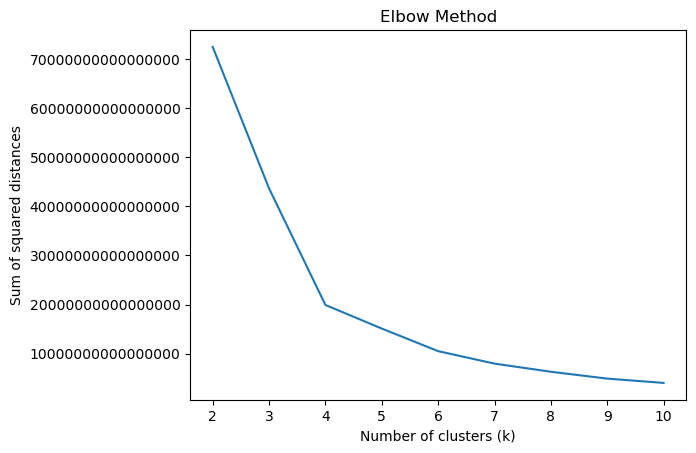

In [48]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Select the features to be used for clustering
#cluster_features = ['num_of_prev_attempts', 'id_assessment', 'date_submitted', 'is_banked', 'score', 'imd_band', 'studied_credits', 'final_result_Distinction', 'final_result_Fail', 'final_result_Pass', 'final_result_Withdrawn', 'code_module_AAA', 'code_module_BBB', 'code_module_CCC', 'code_module_DDD', 'code_module_EEE', 'code_module_FFF', 'code_module_GGG', 'code_presentation_2013B', 'code_presentation_2013J', 'code_presentation_2014B', 'code_presentation_2014J', 'gender_F', 'gender_M', 'region_East Anglian Region', 'region_East Midlands Region', 'region_Ireland', 'region_London Region', 'region_North Region', 'region_North Western Region', 'region_Scotland', 'region_South East Region', 'region_South Region', 'region_South West Region', 'region_Wales', 'region_West Midlands Region', 'region_Yorkshire Region', 'highest_education_A Level or Equivalent', 'highest_education_HE Qualification', 'highest_education_Lower Than A Level', 'highest_education_No Formal quals', 'highest_education_Post Graduate Qualification', 'age_band_0-35', 'age_band_35-55', 'age_band_55<=', 'disability_N', 'disability_Y']

#cluster_data = demopref_data[cluster_features].copy()

# Define a range of possible values for the number of clusters
k_values = range(2, 11)

# Calculate the sum of squared distances (SSE) for each value of k
sse_values = []
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(demopref_data)
    sse_values.append(kmeans.inertia_)

# Plot the SSE for each value of k
plt.plot(k_values, sse_values)
plt.xlabel('Number of clusters (k)')
plt.ylabel('Sum of squared distances')

plt.ticklabel_format(axis='y', style='plain')

plt.title('Elbow Method')
plt.show()


THE ELBOW POINT IS 5-6 Clusters (I will change the model to 6 clusters instead then)









COMBINE THESE TWO (U-I Matrix + DemoPref Clustering) TO FINISH COLLABORATIVE FILTERING

RECOMMEND COURSES BASED ON VLE PREFERENCES & CLUSTER OF TARGET USER

In [38]:
# define the target student ID
target_student_id = 205719

# select the cluster label of the target student
target_student_cluster = demopref_data.loc[demopref_data['id_student'] == target_student_id, 'cluster_label'].values[0]

# find the similar students based on VLE preferences
similar_students = find_similar_users(target_student_id, user_similarity, k=15)

# filter the similar students based on their cluster label
similar_students = demopref_data.loc[demopref_data['cluster_label'] == target_student_cluster & demopref_data['id_student'].isin(similar_students)]

# Find the courses that are most frequently taken by the filtered similar students
freq_courses = similar_students.iloc[:, :7].sum().dropna().sort_values(ascending=False)
freq_courses = freq_courses[freq_courses != 0].nlargest(3)

# Recommend the courses that the target student has not taken yet but are among the most frequently taken courses by the filtered similar students
target_student_courses = demopref_data.loc[demopref_data['id_student'] == target_student_id].iloc[0, :7]
recommended_courses = freq_courses[~target_student_courses.astype(bool)].index.tolist()
print(f"Recommended courses for student {target_student_id}: {recommended_courses}")

Recommended courses for student 205719: ['code_module_DDD', 'code_module_CCC', 'code_module_FFF']


### the following was not run

In [ ]:
# ANOTHER CLUSTERING WITH TEST TO MEASURE ACCURACY
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split

# Select the features to be used for clustering
cluster_features = ['num_of_prev_attempts', 'id_assessment', 'date_submitted', 'is_banked', 'score', 'imd_band', 'studied_credits', 'final_result_Distinction', 'final_result_Fail', 'final_result_Pass', 'final_result_Withdrawn', 'code_module_AAA', 'code_module_BBB', 'code_module_CCC', 'code_module_DDD', 'code_module_EEE', 'code_module_FFF', 'code_module_GGG', 'code_presentation_2013B', 'code_presentation_2013J', 'code_presentation_2014B', 'code_presentation_2014J', 'gender_F', 'gender_M', 'region_East Anglian Region', 'region_East Midlands Region', 'region_Ireland', 'region_London Region', 'region_North Region', 'region_North Western Region', 'region_Scotland', 'region_South East Region', 'region_South Region', 'region_South West Region', 'region_Wales', 'region_West Midlands Region', 'region_Yorkshire Region', 'highest_education_A Level or Equivalent', 'highest_education_HE Qualification', 'highest_education_Lower Than A Level', 'highest_education_No Formal quals', 'highest_education_Post Graduate Qualification', 'age_band_0-35', 'age_band_35-55', 'age_band_55<=', 'disability_N', 'disability_Y']

cluster_data = demopref_data[cluster_features].copy()

# Divide the data into training and testing sets
X_train, X_test = train_test_split(cluster_data, test_size=0.2, random_state=42)

# Perform clustering on the training set
kmeans = KMeans(n_clusters=6, random_state=42)
clusters_train = kmeans.fit_predict(X_train)

# Add the cluster labels as a new column to the training set
X_train['cluster_label'] = clusters_train

# Predict clusters for the testing set
clusters_test = kmeans.predict(X_test)

# Add the cluster labels as a new column to the testing set
X_test['cluster_label'] = clusters_test


In [ ]:
from sklearn.metrics import silhouette_score

test_silhouette_score = silhouette_score(X_test, clusters_test)
train_silhouette_score = silhouette_score(X_train,clusters_train)


print("Silhouette score for train set:", train_silhouette_score)
print("Silhouette score for test set:", test_silhouette_score)

In [ ]:
# Perform DBSCAN

X_train, X_test = train_test_split(cluster_data, test_size=0.1, random_state=42)

dbscan = DBSCAN(eps=2, min_samples=10)

dbscan_train_clusters = dbscan.fit_predict(X_train)
dbscan_train_silhouette = silhouette_score(X_train, dbscan_train_clusters)
X_train['dbscan_cluster_label'] = dbscan_train_clusters

dbscan_test_clusters = dbscan.fit_predict(X_test)
dbscan_test_silhouette = silhouette_score(X_test, dbscan_test_clusters)
X_test['dbscan_cluster_label'] = dbscan_test_clusters


Hyper Parameter Tuning for DBSCAN

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {'eps': [0.5, 1.0, 1.5],
              'min_samples': [5, 10, 15]}

# Create a DBSCAN object
dbscan = DBSCAN()

# Create a GridSearchCV object
grid_search = GridSearchCV(dbscan, param_grid=param_grid, scoring='silhouette')

# Fit the grid search object to the data
grid_search.fit(X_train)

# Get the best parameters and the corresponding silhouette score
best_params = grid_search.best_params_
best_score = grid_search.best_score_
